In [28]:
import tensorflow as tf
import os
import numpy as np
import sys
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report
from tensorflow.keras.applications.resnet50 import preprocess_input
import cv2
import random
from collections import Counter

In [3]:
seed=1234
random.seed(seed)
np.random.seed(seed)
tf.random.set_seed(seed)

In [4]:
img_w, img_h = 224, 224
batch_size = 32
epoch = 200
filename = 'D:/DL_learn/Homework/dataset/ResNet50_1234.h5'

In [5]:
resnet_extractor = tf.keras.applications.ResNet50(weights="imagenet", include_top=False, input_shape=(img_w, img_h, 3))
resnet_extractor.trainable = False
x = resnet_extractor.output
x = tf.keras.layers.Flatten()(x)
x = tf.keras.layers.Dense(1024, activation="relu")(x)
x = tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(512, activation="relu")(x)
x = tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(512, activation="relu")(x)
x = tf.keras.layers.Dropout(0.5)(x)
num_classes = 4  # จำนวนคลาสในชุดข้อมูลที่อัปเดตของคุณ
new_outputs = tf.keras.layers.Dense(num_classes, activation="softmax")(x)

In [6]:
model = tf.keras.models.Model(inputs=resnet_extractor.input, outputs=new_outputs)
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                              

In [6]:
model.compile(
    optimizer=tf.keras.optimizers.Adam(),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

In [10]:
dataset = tf.keras.preprocessing.image_dataset_from_directory(
    'D:/DL_learn/Homework/dataset',
    image_size=(img_h, img_w),
    batch_size=batch_size,
    label_mode='int',  # Integer labels
    shuffle=True,
    seed=seed
)

Found 400 files belonging to 4 classes.


In [11]:
# Initialize lists to accumulate batches
x_batches = []
y_batches = []

# Iterate through the dataset to collect batches
for x_batch, y_batch in dataset:
    x_batches.append(x_batch.numpy())  # Convert tf.Tensor to NumPy array
    y_batches.append(y_batch.numpy())  # Convert tf.Tensor to NumPy array

# Concatenate batches into NumPy arrays
x_data = np.concatenate(x_batches, axis=0)
y_data = np.concatenate(y_batches, axis=0)

# Now x_data and y_data are NumPy arrays containing all data from the dataset
print("Shape of x_data:", x_data.shape)
print("Shape of y_data:", y_data.shape)

Shape of x_data: (400, 224, 224, 3)
Shape of y_data: (400,)


In [12]:
# แบ่งชุดข้อมูลเป็น train และ test ด้วยการใช้ stratification
x_train, x_test, y_train, y_test = train_test_split(
    x_data, y_data, test_size=0.2, random_state=seed, stratify=y_data
)

# แบ่ง train เป็น train และ validation
x_train, x_val, y_train, y_val = train_test_split(
    x_train, y_train, test_size=0.2, random_state=seed, stratify=y_train
)

# x_train = preprocess_input(x_train)
# x_test = preprocess_input(x_test)
# x_val = preprocess_input(x_val)

# แปลง NumPy arrays กลับไปเป็น tf.data.Dataset
train_dataset = tf.data.Dataset.from_tensor_slices((x_train, y_train)).batch(batch_size)
val_dataset = tf.data.Dataset.from_tensor_slices((x_val, y_val)).batch(batch_size)
test_dataset = tf.data.Dataset.from_tensor_slices((x_test, y_test)).batch(batch_size)

['Varanus dumerilii', 'Varanus nebulosus', 'Varanus rudicollis', 'Varanus salvator']


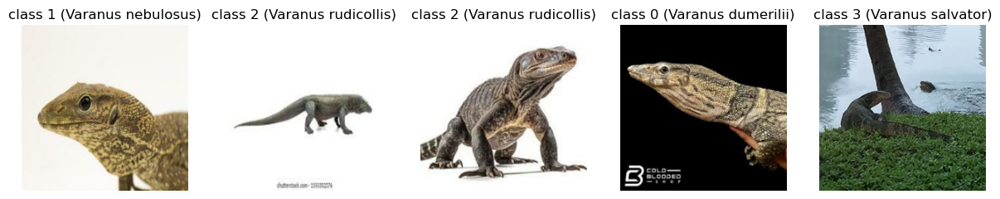

In [20]:
# #visualize the first 5 image
class_names = dataset.class_names
print(class_names)
plt.figure(figsize=(15, 5))
for i in range(5):
    plt.subplot(1, 5, i + 1)
    plt.title(f'class {y_train[i]} ({class_names[y_train[i]]})')
    plt.imshow(np.clip(x_train[i] / 255.0, 0, 1))  # Normalize and clip to valid range
    plt.axis('off')
plt.show()

In [11]:
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.RandomFlip("horizontal_and_vertical"),
    tf.keras.layers.RandomRotation(0.2),
    tf.keras.layers.RandomZoom(0.2),
    tf.keras.layers.RandomContrast(0.1)
])

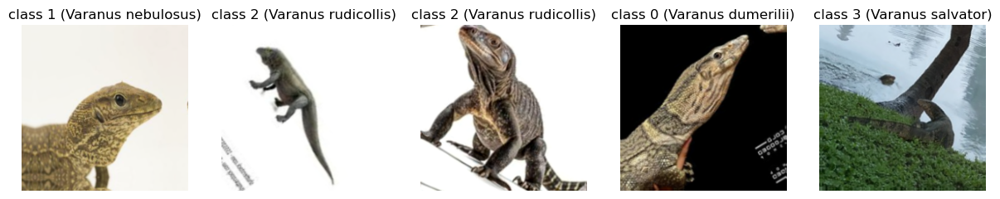

In [12]:
train_dataset = train_dataset.map(lambda x, y: (data_augmentation(x, training=True), y))
for augmented_images, labels in train_dataset.take(1):
    augmented_images = augmented_images.numpy()
    labels = labels.numpy()

    # Plot the augmented images
    plt.figure(figsize=(15, 5))
    for i in range(5):
        plt.subplot(1, 5, i + 1)
        plt.title(f'class {labels[i]} ({class_names[labels[i]]})')
        plt.imshow(np.clip(augmented_images[i] / 255.0, 0, 1))  # Normalize and clip to valid range
        plt.axis('off')
    plt.show()

In [13]:
#model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(filepath=filename,
#                                                                save_weights_only=False,
#                                                                monitor='val_loss',
#                                                                mode='min',
#                                                                save_best_only=True)

In [14]:
history = model.fit(
    train_dataset,
    epochs=epoch,
    verbose=1,
    validation_data=val_dataset,
    #callbacks=[model_checkpoint_callback]
)

Epoch 1/200
8/8 [==============================] - 6s 245ms/step - loss: 33.7654 - accuracy: 0.3008 - val_loss: 10.3988 - val_accuracy: 0.4062
Epoch 2/200
8/8 [==============================] - 1s 170ms/step - loss: 40.9985 - accuracy: 0.2617 - val_loss: 14.3668 - val_accuracy: 0.4844
Epoch 3/200
8/8 [==============================] - 1s 169ms/step - loss: 31.1728 - accuracy: 0.3477 - val_loss: 6.8711 - val_accuracy: 0.5469
Epoch 4/200
8/8 [==============================] - 1s 168ms/step - loss: 21.7213 - accuracy: 0.3672 - val_loss: 4.2156 - val_accuracy: 0.5000
Epoch 5/200
8/8 [==============================] - 1s 170ms/step - loss: 11.7131 - accuracy: 0.4805 - val_loss: 2.7411 - val_accuracy: 0.6719
Epoch 6/200
8/8 [==============================] - 1s 173ms/step - loss: 10.7194 - accuracy: 0.5273 - val_loss: 3.2736 - val_accuracy: 0.5938
Epoch 7/200
8/8 [==============================] - 1s 171ms/step - loss: 9.2212 - accuracy: 0.5039 - val_loss: 1.7267 - val_accuracy: 0.6562
Epoch

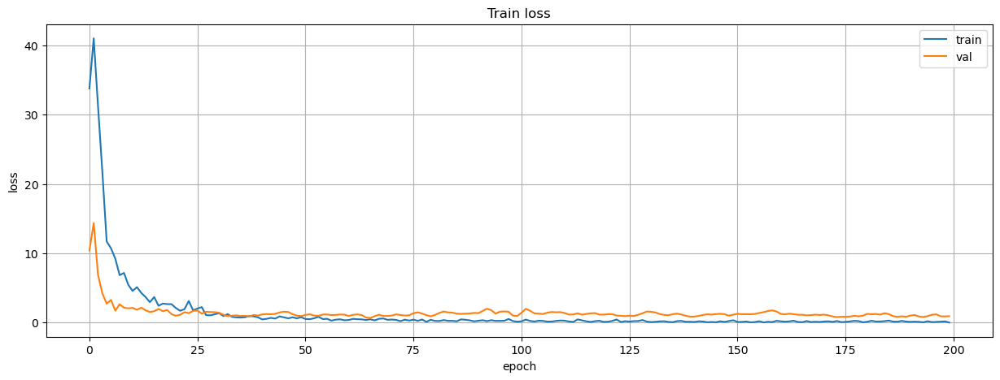

In [15]:
plt.figure(figsize=(15,5))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Train loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper right')
plt.grid()
plt.show()

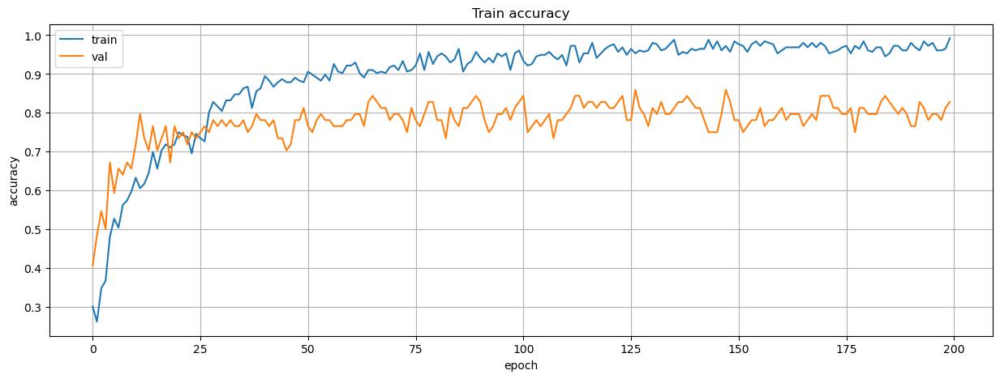

In [16]:
# Summarize history for accuracy
plt.figure(figsize=(15, 5))
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Train accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.grid()
plt.show()

In [17]:
model.save(filename)

In [7]:
saved_model = tf.keras.models.load_model(filename)

In [14]:
test_dataset = test_dataset.unbatch().batch(1)  # ยกเลิกการแบ่งแบทช์และแบ่งแบทช์ขนาด 1 สำหรับการประเมิน
predictions = saved_model.predict(test_dataset)
y_pred = tf.argmax(predictions, axis=1)
y_true = np.concatenate([y for x, y in test_dataset], axis=0)

80/80 [==============================] - 13s 20ms/step


In [15]:
y_pred

<tf.Tensor: shape=(80,), dtype=int64, numpy=
array([2, 1, 3, 3, 3, 0, 1, 3, 2, 2, 2, 1, 3, 1, 3, 3, 2, 3, 2, 3, 0, 2,
       0, 1, 3, 1, 2, 3, 2, 0, 2, 2, 1, 2, 2, 0, 3, 2, 3, 3, 2, 0, 0, 1,
       0, 1, 3, 0, 0, 3, 2, 1, 3, 2, 1, 3, 3, 0, 2, 3, 0, 0, 2, 0, 2, 3,
       2, 0, 1, 2, 1, 0, 3, 0, 2, 1, 2, 2, 0, 3], dtype=int64)>

In [16]:
y_true

array([1, 1, 1, 3, 3, 0, 2, 3, 1, 2, 2, 1, 1, 1, 3, 3, 2, 3, 0, 3, 0, 2,
       0, 3, 3, 1, 1, 3, 2, 0, 2, 2, 1, 2, 2, 0, 3, 1, 0, 3, 2, 0, 0, 1,
       0, 1, 3, 0, 0, 3, 2, 1, 3, 1, 2, 3, 1, 0, 2, 3, 0, 0, 2, 0, 3, 3,
       2, 0, 1, 2, 1, 0, 2, 0, 1, 1, 2, 2, 0, 3])

In [22]:
report = classification_report(y_true, y_pred, target_names=class_names)
print(report)

                    precision    recall  f1-score   support

 Varanus dumerilii       1.00      0.90      0.95        20
 Varanus nebulosus       0.79      0.55      0.65        20
Varanus rudicollis       0.68      0.85      0.76        20
  Varanus salvator       0.78      0.90      0.84        20

          accuracy                           0.80        80
         macro avg       0.81      0.80      0.80        80
      weighted avg       0.81      0.80      0.80        80



In [23]:
# ฟังก์ชันสำหรับ decode predictions
def decode_predictions(preds, top=5):
    results = []
    for pred in preds:
        top_indices = pred.argsort()[-top:][::-1]
        result = [(i, class_names[i], pred[i]) for i in top_indices]
        results.append(result)
    return results

In [24]:
# ฟังก์ชัน GradCAM
def my_CNN_GradCAM(model, in_img, class_index, normalize=True):
    in_img = tf.cast(in_img, tf.float32)
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer("conv5_block3_out").output, model.output]
    )
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(in_img)
        loss = predictions[:, class_index]
    grads = tape.gradient(loss, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs.numpy()[0]
    pooled_grads = pooled_grads.numpy()
    for i in range(pooled_grads.shape[-1]):
        conv_outputs[:, :, i] *= pooled_grads[i]
    heatmap = np.mean(conv_outputs, axis=-1)
    heatmap = np.maximum(heatmap, 0)
    
    if np.max(heatmap) > 0:  # Avoid division by zero
        heatmap /= np.max(heatmap)
        
    return heatmap if normalize else heatmap

In [25]:
def visualize_GradCAM_topresult(model, original_img, input_img, logit_preds, top=5, heatmap_norm=True):
    top_results = decode_predictions(logit_preds, top=top)
    top_index = [tp[0] for tp in top_results[0]]

    for i, c in enumerate(top_index):
        heatmap = my_CNN_GradCAM(model, input_img, c, heatmap_norm)
        heatmap = heatmap / np.max(heatmap) if np.max(heatmap) > 0 else heatmap  # Normalize heatmap
        fig = plt.figure(figsize=(15, 5))
        class_desc = f"{class_names[c]}, Top {i+1}/{top} with a logit score of {logit_preds[..., c].squeeze():.4f}"
        class_desc += f", normalized" if heatmap_norm else f", unnormalized"
        fig.suptitle(f"Class no. {c}/{len(class_names)-1} ({class_desc})")

        ax = fig.add_subplot(1, 2, 1)
        ax.set_title("Original Grad-CAM")
        im = ax.imshow(heatmap, cmap='jet')
        plt.colorbar(im, ax=ax)

        ax = fig.add_subplot(1, 2, 2)
        ax.set_title("Resized Grad-CAM on an input image")
        
        # Normalize the original image if necessary
        if original_img.max() > 1.0:
            original_img = original_img / 255.0
        
        ax.imshow(original_img)
        alpha = 0.6
        im = ax.imshow(cv2.resize(heatmap, original_img.shape[:2]), cmap='jet', alpha=alpha)
        plt.colorbar(im, ax=ax)

        plt.show()

In [26]:
def visualize_GradCAM_topresult2(model, original_img, input_img, logit_preds, class_names, top=1, heatmap_norm=True):
    top_results = decode_predictions(logit_preds, top=top)
    top_index = [tp[0] for tp in top_results[0]]

    for i, c in enumerate(top_index):
        heatmap = my_CNN_GradCAM(model, input_img, c, heatmap_norm)
        heatmap = heatmap / np.max(heatmap) if np.max(heatmap) > 0 else heatmap  # Normalize heatmap
        fig = plt.figure(figsize=(15, 5))
        class_desc = f"{class_names[c]}, Top {i+1}/{top} with a logit score of {logit_preds[..., c].squeeze():.4f}"
        class_desc += f", normalized" if heatmap_norm else f", unnormalized"
        fig.suptitle(f"Class no. {c}/{len(class_names)-1} ({class_desc})")

        ax = fig.add_subplot(1, 2, 1)
        ax.set_title("Original Grad-CAM")
        im = ax.imshow(heatmap, cmap='jet')
        plt.colorbar(im, ax=ax)

        ax = fig.add_subplot(1, 2, 2)
        ax.set_title("Resized Grad-CAM on an input image")
        
        # Normalize the original image if necessary
        if original_img.max() > 1.0:
            original_img = original_img / 255.0
        
        ax.imshow(original_img)
        alpha = 0.6
        im = ax.imshow(cv2.resize(heatmap, original_img.shape[:2]), cmap='jet', alpha=alpha)
        plt.colorbar(im, ax=ax)

        plt.show()

In [27]:
# เตรียมข้อมูลสำหรับ visualize_GradCAM_topresult
img1 = x_test[1]  # ตัวอย่างภาพจากชุดทดสอบ
img_preprocess1 = tf.keras.applications.resnet50.preprocess_input(img1.copy())  # เตรียมภาพสำหรับการพยากรณ์
img_preprocess1 = np.expand_dims(img_preprocess1, axis=0)  # เพิ่มมิติให้เป็น batch

out_linear1 = saved_model.predict(img_preprocess1)  # พยากรณ์ด้วยโมเดล

1/1 [==============================] - 0s 497ms/step


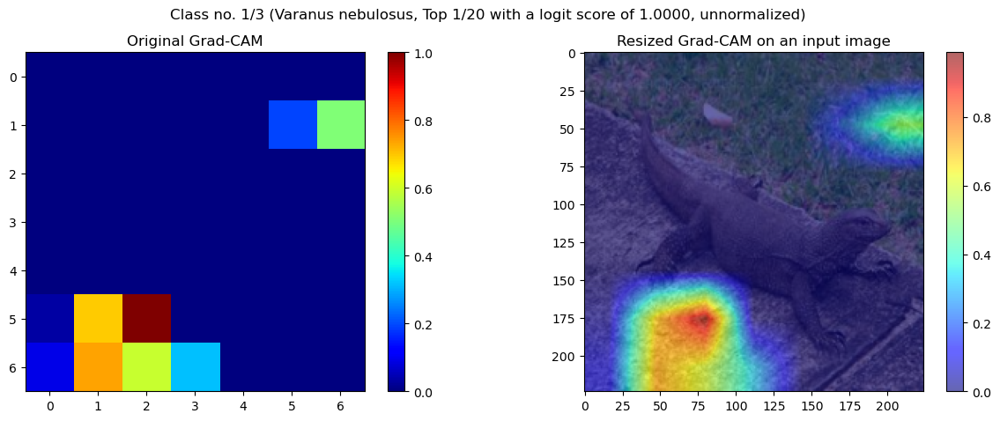

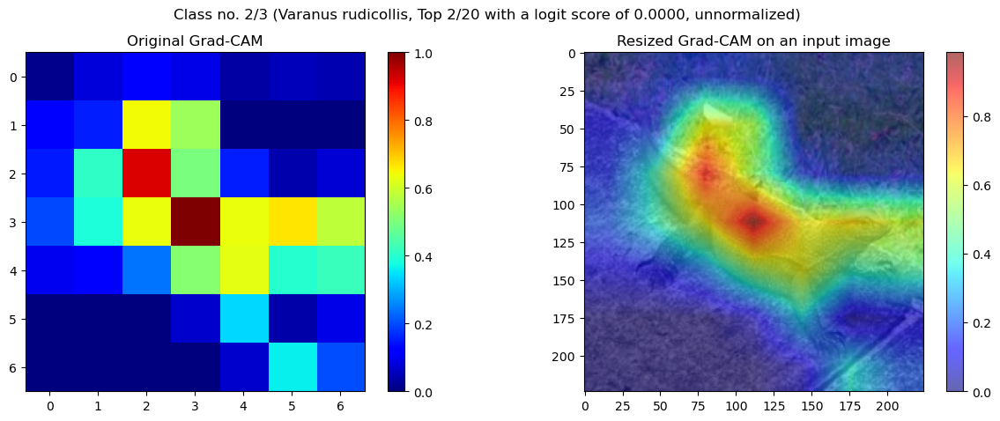

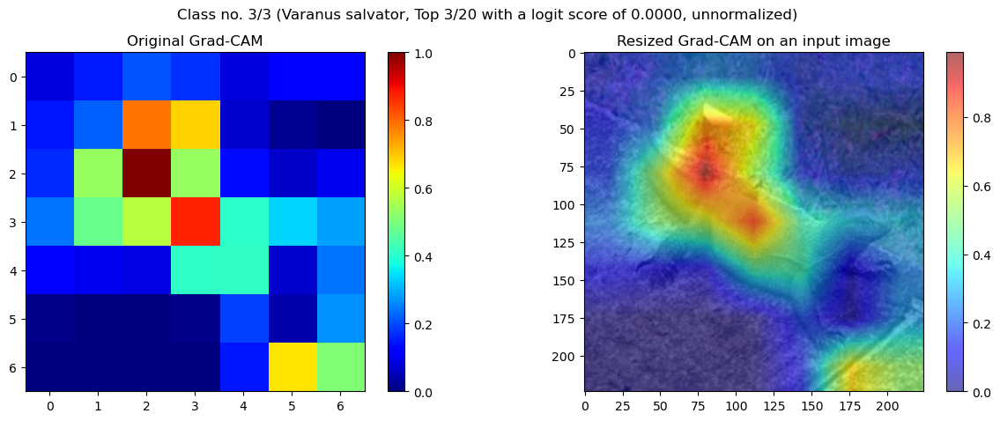

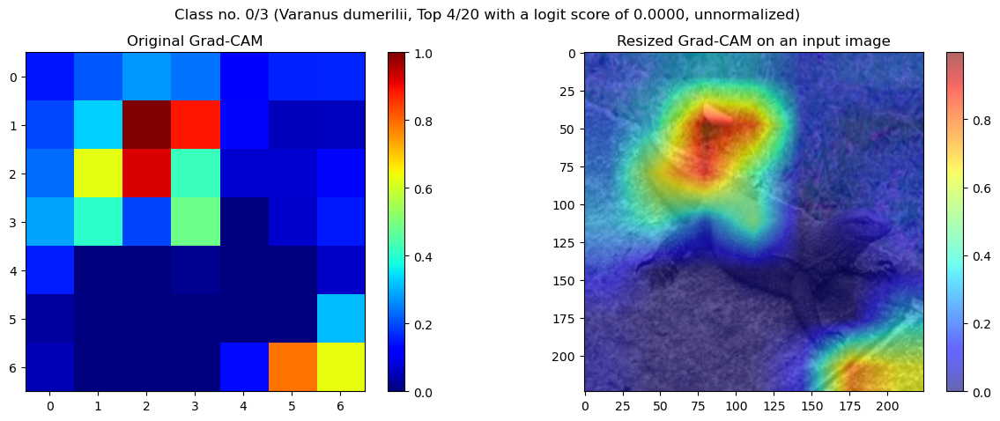

In [28]:
# ฟังก์ชัน visualize_GradCAM_topresult
visualize_GradCAM_topresult(saved_model, img1, img_preprocess1, out_linear1, top=20, heatmap_norm=False)

In [29]:
correct_indices = np.where(y_pred == y_true)[0]
test_images = np.concatenate([x.numpy() for x, y in test_dataset], axis=0)
X_correct = test_images[correct_indices]
y_correct = y_true[correct_indices]
y_pred_correct = predictions[correct_indices]
print(correct_indices)

# Map the indices to breed names
y_correct_breeds = [dataset.class_names[i] for i in y_correct]
print(y_correct_breeds)

breed_counts = Counter(y_correct_breeds)
print(breed_counts)

[ 1  3  4  5  7  9 10 11 13 14 15 16 17 19 20 21 22 24 25 27 28 29 30 31
 32 33 34 35 36 39 40 41 42 43 44 45 46 47 48 49 50 51 52 55 57 58 59 60
 61 62 63 65 66 67 68 69 70 71 73 75 76 77 78 79]
['Varanus nebulosus', 'Varanus salvator', 'Varanus salvator', 'Varanus dumerilii', 'Varanus salvator', 'Varanus rudicollis', 'Varanus rudicollis', 'Varanus nebulosus', 'Varanus nebulosus', 'Varanus salvator', 'Varanus salvator', 'Varanus rudicollis', 'Varanus salvator', 'Varanus salvator', 'Varanus dumerilii', 'Varanus rudicollis', 'Varanus dumerilii', 'Varanus salvator', 'Varanus nebulosus', 'Varanus salvator', 'Varanus rudicollis', 'Varanus dumerilii', 'Varanus rudicollis', 'Varanus rudicollis', 'Varanus nebulosus', 'Varanus rudicollis', 'Varanus rudicollis', 'Varanus dumerilii', 'Varanus salvator', 'Varanus salvator', 'Varanus rudicollis', 'Varanus dumerilii', 'Varanus dumerilii', 'Varanus nebulosus', 'Varanus dumerilii', 'Varanus nebulosus', 'Varanus salvator', 'Varanus dumerilii', 'Varanu

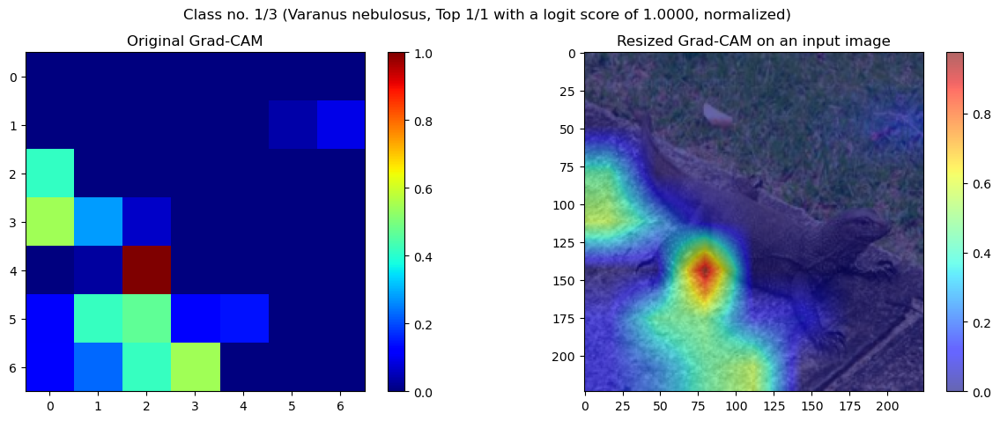

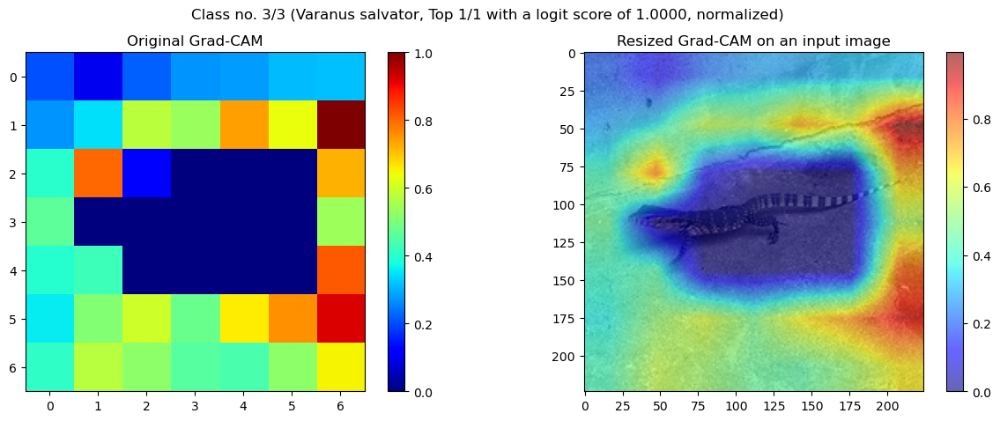

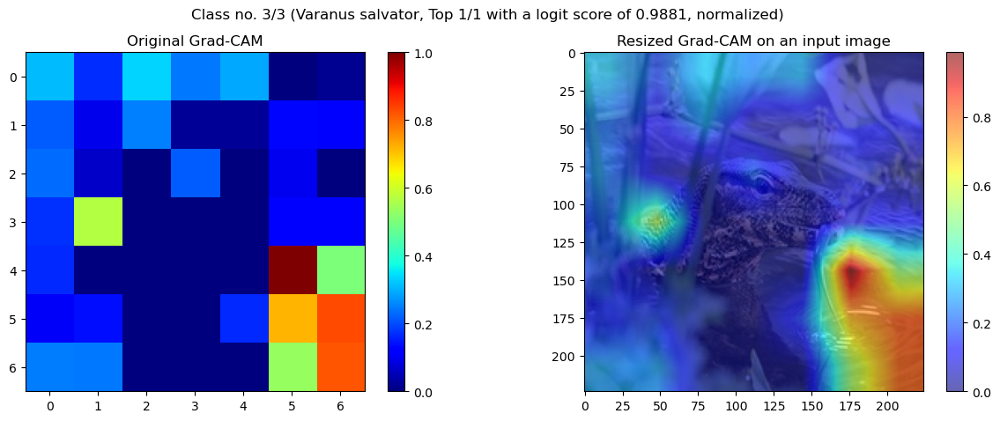

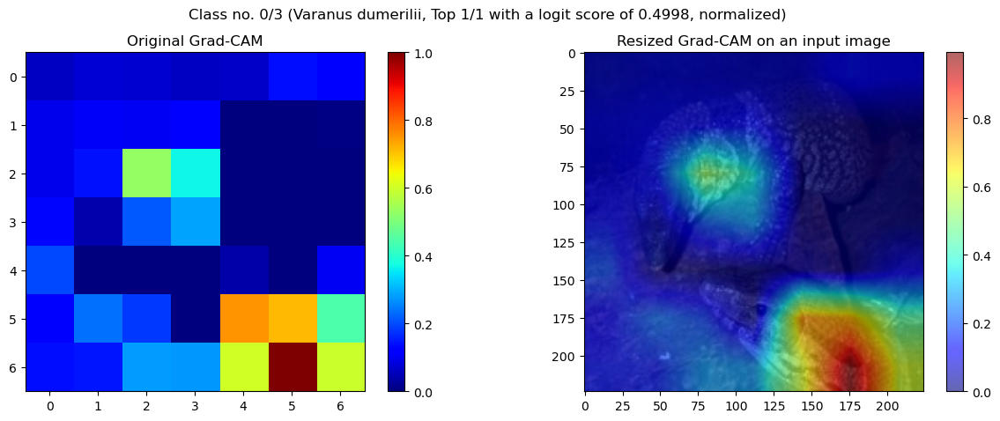

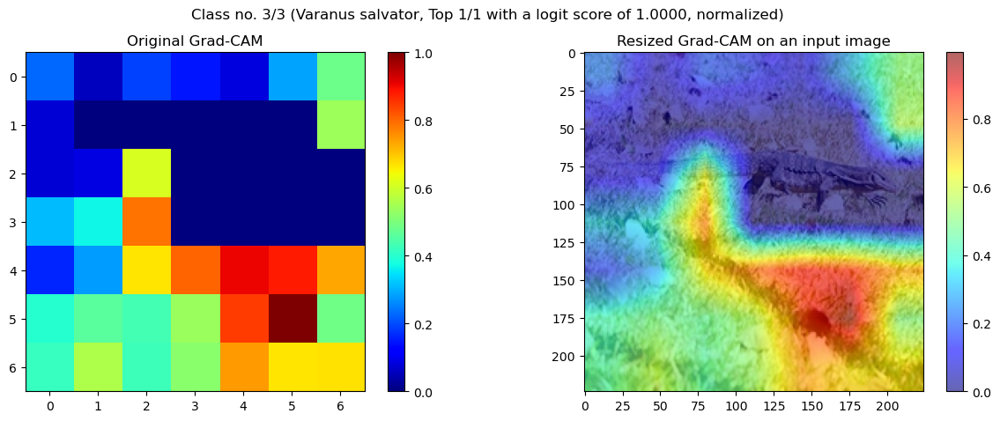

...

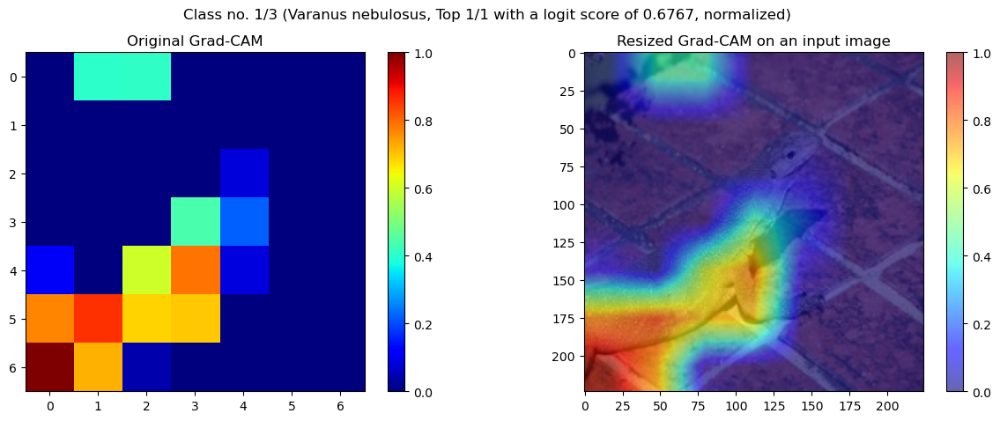

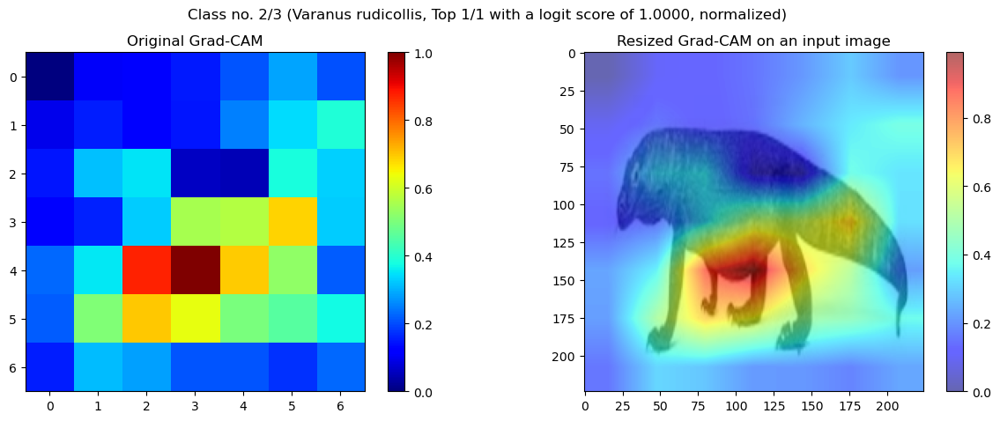

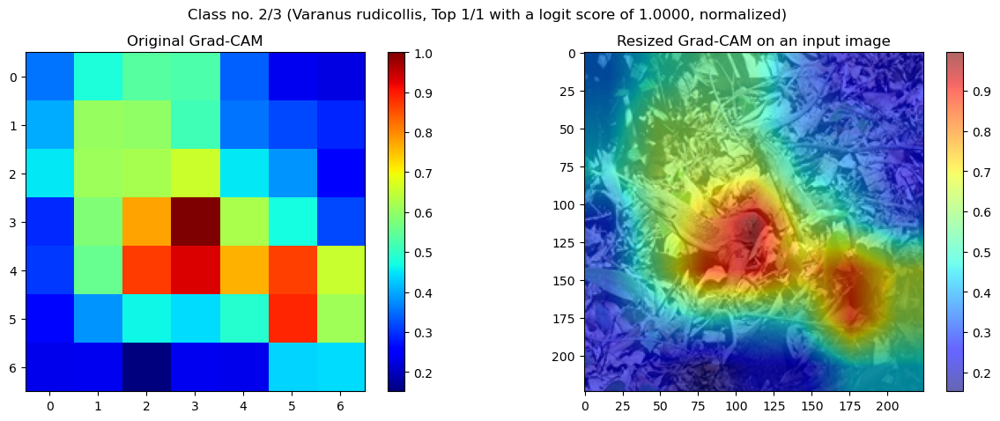

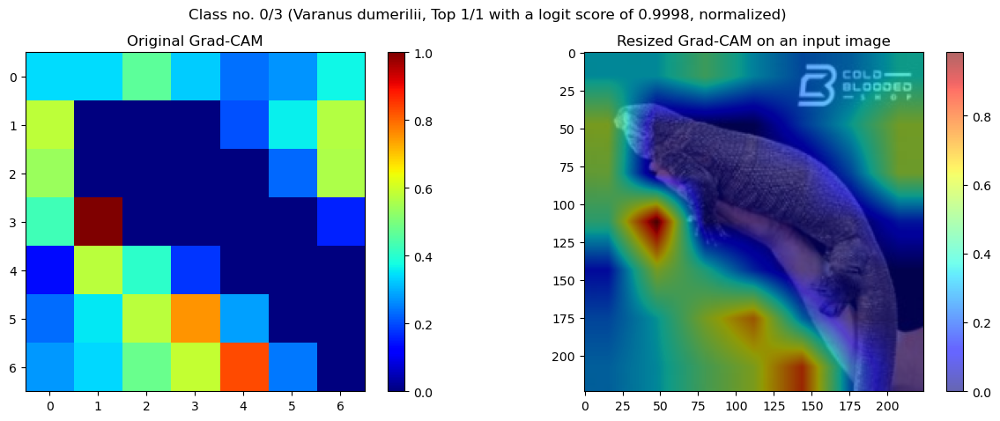

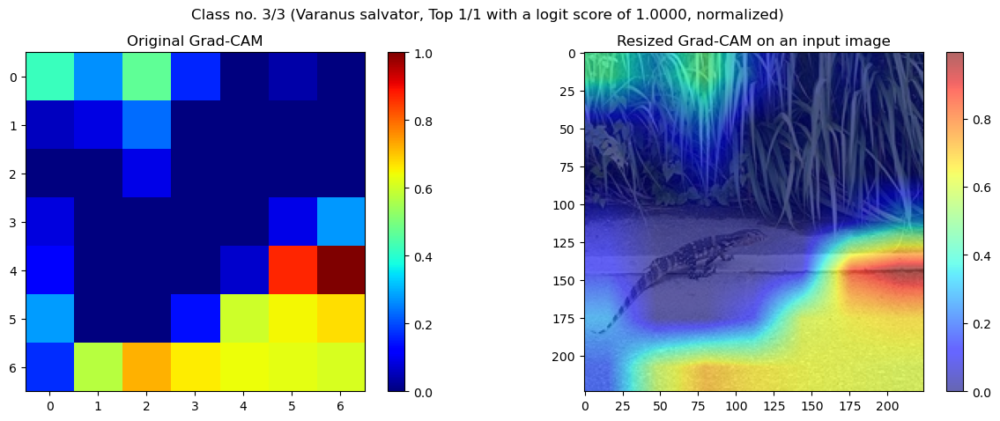

In [30]:
for i in range(len(X_correct)):
    original_img = X_correct[i]
    input_img = np.expand_dims(original_img, axis=0)  # เตรียมภาพสำหรับการทำนาย
    logit_preds = y_pred_correct[i].reshape(1, -1)  # เตรียม logit สำหรับภาพ

    # แสดงเฉพาะคลาสที่มี logit score สูงสุดเท่านั้น
    visualize_GradCAM_topresult2(model, original_img, input_img, logit_preds, class_names, top=1, heatmap_norm=True)